# Analiza obrazu - detekcja twarzy

In [ ]:
import cv2
from google.colab.patches import cv2_imshow

import dlib
import time

## Inicjalizacja - pobranie obrazów i modeli dla detektorów twarzy

In [ ]:
# https://drive.google.com/file/d/1gn7itC80mnmp9TSK8PHMEZSKMOuBVUEQ/view?usp=sharing
!gdown --id 1gn7itC80mnmp9TSK8PHMEZSKMOuBVUEQ

Downloading...
From: https://drive.google.com/uc?id=1gn7itC80mnmp9TSK8PHMEZSKMOuBVUEQ
To: /content/2_Demonstration_Demonstration_Or_Protest_2_1.jpg
100% 147k/147k [00:00<00:00, 44.4MB/s]


In [ ]:
# https://drive.google.com/file/d/1bDxbUhSj2724V_27IVn2ZYcUjBRuIDnZ/view?usp=sharing
!gdown --id 1bDxbUhSj2724V_27IVn2ZYcUjBRuIDnZ

Downloading...
From: https://drive.google.com/uc?id=1bDxbUhSj2724V_27IVn2ZYcUjBRuIDnZ
To: /content/58_Hockey_icehockey_puck_58_94.jpg
100% 110k/110k [00:00<00:00, 39.7MB/s]


In [ ]:
# https://drive.google.com/file/d/1jKrxWEXTACIdwOD9ClLtHGcDkU0jTdz1/view?usp=sharing
!gdown --id 1jKrxWEXTACIdwOD9ClLtHGcDkU0jTdz1

Downloading...
From: https://drive.google.com/uc?id=1jKrxWEXTACIdwOD9ClLtHGcDkU0jTdz1
To: /content/37_Soccer_Soccer_37_365.jpg
100% 95.8k/95.8k [00:00<00:00, 35.0MB/s]


In [ ]:
# https://drive.google.com/file/d/1UoFK0Jl7tY1z0ykdlvaxkFmyUR8lmLul/view?usp=sharing

!gdown --id 1UoFK0Jl7tY1z0ykdlvaxkFmyUR8lmLul

Downloading...
From: https://drive.google.com/uc?id=1UoFK0Jl7tY1z0ykdlvaxkFmyUR8lmLul
To: /content/haarcascade_frontalface_default.xml
100% 930k/930k [00:00<00:00, 29.6MB/s]


In [ ]:
# https://drive.google.com/file/d/1tb4P8NEcwTnja182AFDDnXM5ijTNQwj_/view?usp=sharing
!gdown --id 1tb4P8NEcwTnja182AFDDnXM5ijTNQwj_

Downloading...
From: https://drive.google.com/uc?id=1tb4P8NEcwTnja182AFDDnXM5ijTNQwj_
To: /content/mmod_human_face_detector.dat
100% 730k/730k [00:00<00:00, 108MB/s]


### Weryfikacja pobranych danych

In [ ]:
# 0f8c44e5e564e71d95bb3f5247ebae20  2_Demonstration_Demonstration_Or_Protest_2_1.jpg
!md5sum 2_Demonstration_Demonstration_Or_Protest_2_1.jpg

0f8c44e5e564e71d95bb3f5247ebae20  2_Demonstration_Demonstration_Or_Protest_2_1.jpg


In [ ]:
# a03f92a797e309e76e6a034ab9e02616  haarcascade_frontalface_default.xml
!md5sum haarcascade_frontalface_default.xml

a03f92a797e309e76e6a034ab9e02616  haarcascade_frontalface_default.xml


In [ ]:
# 2ac022385c5a56f8313ca9827ff76c3d  mmod_human_face_detector.dat
!md5sum mmod_human_face_detector.dat

2ac022385c5a56f8313ca9827ff76c3d  mmod_human_face_detector.dat


### Wczytanie obrazów

In [ ]:
img_test = cv2.imread("2_Demonstration_Demonstration_Or_Protest_2_1.jpg")
img_soccer = cv2.imread("37_Soccer_Soccer_37_365.jpg")
img_hockey = cv2.imread("58_Hockey_icehockey_puck_58_94.jpg")

## Kaskada Haara

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/05/opencv-face-detection-with-haar-cascades/

In [ ]:
"""
scaleFactor: How much the image size is reduced at each image scale.
minNeighbors: How many neighbors each window should have for the area in the window to be considered a face.
minSize: A tuple of width and height (in pixels) indicating the window’s minimum size.
"""
def detect_haar(img, scaleFactor, minNeighbors, minSize):
  haar_detector = cv2.CascadeClassifier("haarcascade_frontalface_default.xml")
  gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  start = time.time()
  rects = haar_detector.detectMultiScale(gray, scaleFactor=scaleFactor,
                                    minNeighbors=minNeighbors, minSize=minSize,
                                    flags=cv2.CASCADE_SCALE_IMAGE)
  end = time.time()
  print(f"Czas wykonania kaskady Haara: {end-start:.3f}s")
  img_haar = img.copy()
  for (x, y, w, h) in rects:
    cv2.rectangle(img_haar, (x, y), (x + w, y + h), (0, 255, 0), 2)
  return img_haar

## Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

---



Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [ ]:
def convert_and_trim_bb(image, rect):
	# extract the starting and ending (x, y)-coordinates of the
	# bounding box
	startX = rect.left()
	startY = rect.top()
	endX = rect.right()
	endY = rect.bottom()
	# ensure the bounding box coordinates fall within the spatial
	# dimensions of the image
	startX = max(0, startX)
	startY = max(0, startY)
	endX = min(endX, image.shape[1])
	endY = min(endY, image.shape[0])
	# compute the width and height of the bounding box
	w = endX - startX
	h = endY - startY
	# return our bounding box coordinates
	return (startX, startY, w, h)

In [ ]:
def detect_hog_svm(img):
  hog_svm_detector = dlib.get_frontal_face_detector()
  rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  start = time.time()
  hog_svm_rects = hog_svm_detector(rgb, 1)
  end = time.time()
  print(f"Czas wykonania HOG + SVM: {end-start:.3f}s")
  hog_svm_boxes = [convert_and_trim_bb(img, r) for r in hog_svm_rects]

  img_hog_svm = img.copy()
  for (x, y, w, h) in hog_svm_boxes:
    cv2.rectangle(img_hog_svm, (x, y), (x + w, y + h), (0, 255, 0), 2)
  return img_hog_svm

## Splotowa sieć neuronowa (CNN)

Opracowano na podstawie: https://www.pyimagesearch.com/2021/04/19/face-detection-with-dlib-hog-and-cnn/

In [ ]:
def detect_cnn(img):
  cnn_detector = dlib.cnn_face_detection_model_v1('mmod_human_face_detector.dat')
  rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
  start = time.time()
  cnn_rects = cnn_detector(rgb, 1)
  end = time.time()
  print(f"Czas wykonania CNN: {end-start:.3f}s")
  cnn_boxes = [convert_and_trim_bb(img, r.rect) for r in cnn_rects]

  img_cnn = img.copy()
  for (x, y, w, h) in cnn_boxes:
    cv2.rectangle(img_cnn, (x, y), (x + w, y + h), (0, 255, 0), 2)
  return img_cnn

## Przyjęte miary efektywności algorytmów detekcji twarzy
- procent poprawnie wykrytych twarzy w obrazie (liczba twarzy poprawnie wykrytych w stosunku do liczby wszystkich twarzy), 
- procent/liczba niewykrytych twarzy w obrazie, 
- liczba obiektów niepoprawnie rozpoznanych jako twarze.

## Obraz testowy

---


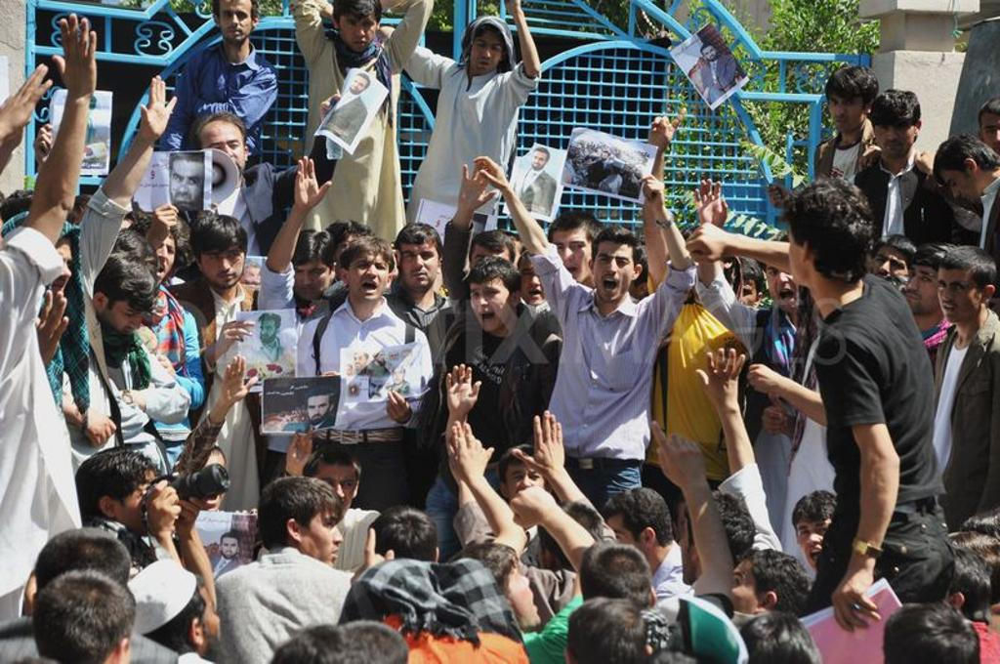

In [ ]:
cv2_imshow(img_test)

### Liczba twarzy
Na obrazie testowym doliczyłem się 40 twarzy.

### Kaskada Haara

#### Dla `minNeighbors` = 5 i `minSize` = (30, 30)

Czas wykonania kaskady Haara: 1.324s


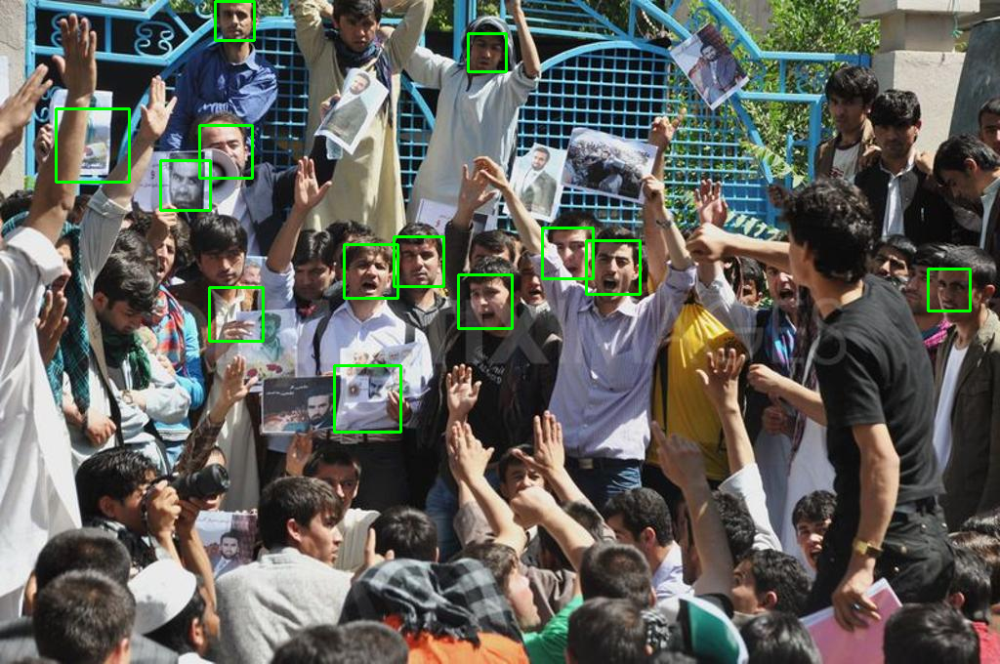

In [ ]:
res = detect_haar(img_test, 1.05, 5, (30, 30))
cv2_imshow(res)

##### Wartości miar efektywności
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{10}{40})\cdot100\% = 25\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{30}{40})\cdot100\% = 75\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $2$

#### Dla `minNeighbors` = 13 i `minSize` = (30, 30)

Czas wykonania kaskady Haara: 1.210s


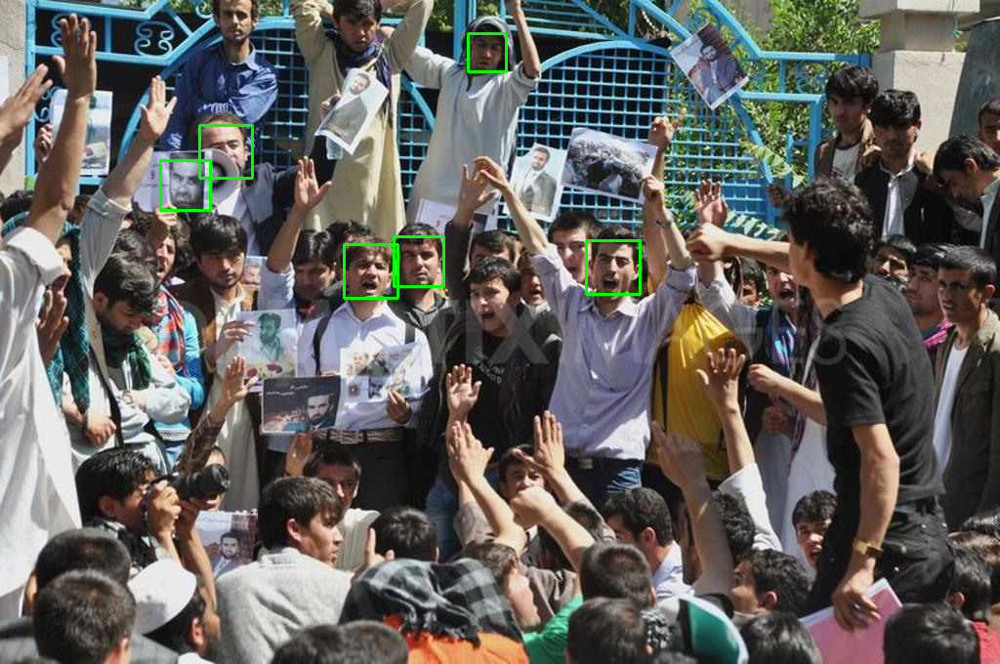

In [ ]:
res = detect_haar(img_test, 1.05, 13, (30, 30))
cv2_imshow(res)

##### Wartości miar efektywności
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{6}{40})\cdot100\% = 15\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{34}{40})\cdot100\% = 85\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

#### Dla `minNeighbors` = 13 i `minSize` = (3, 3)

Czas wykonania kaskady Haara: 1.429s


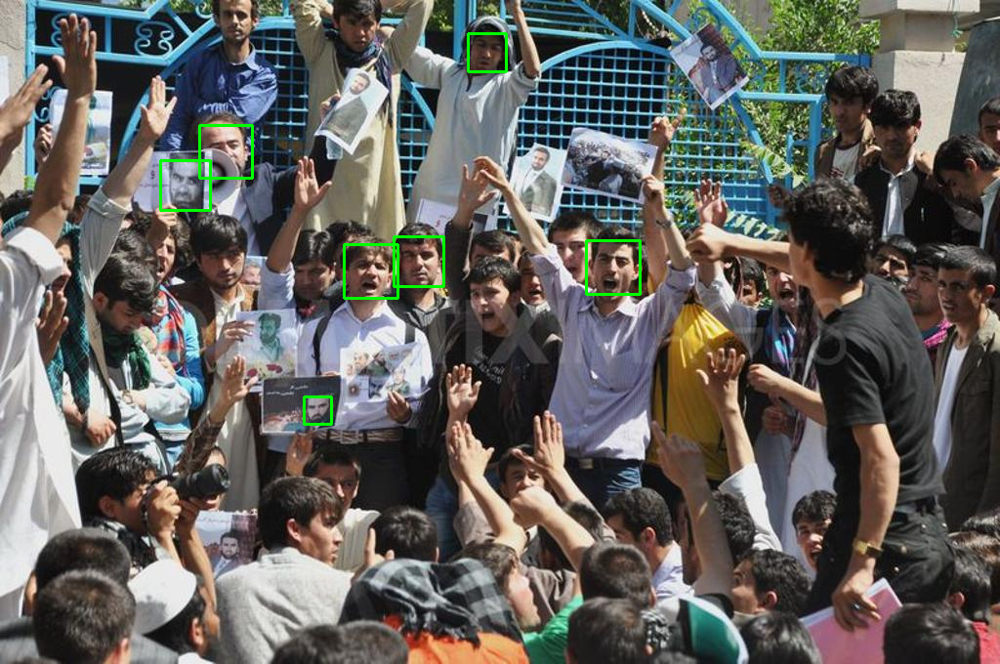

In [ ]:
res = detect_haar(img_test, 1.05, 13, (3, 3))
cv2_imshow(res)

##### Wartości miar efektywności
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{7}{40})\cdot100\% \approx 18\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{34}{40})\cdot100\% \approx 82\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

### Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)


Czas wykonania HOG + SVM: 0.631s


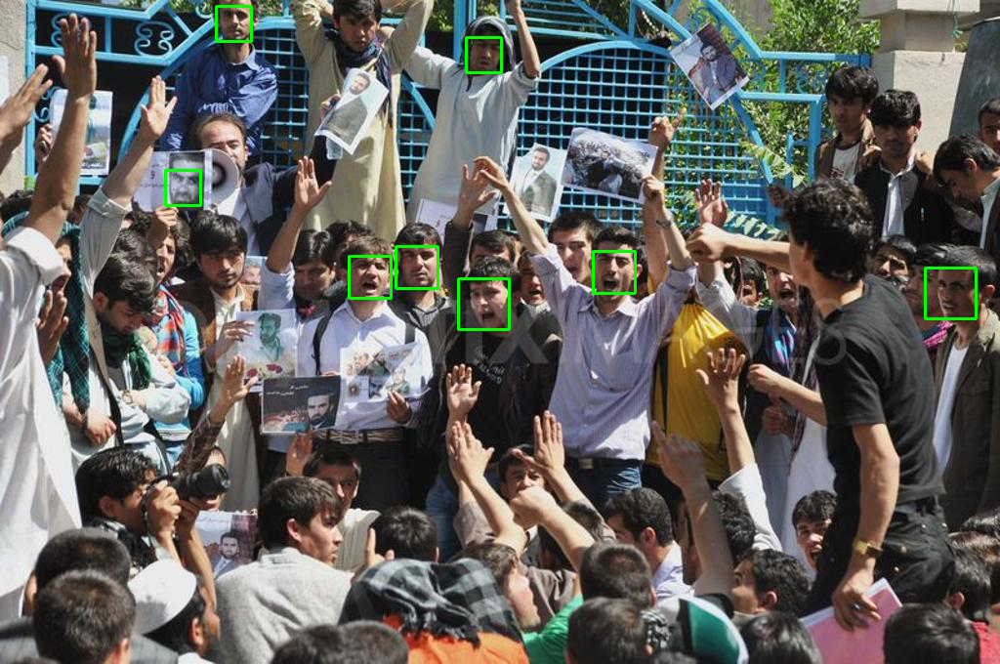

In [ ]:
res = detect_hog_svm(img_test)
cv2_imshow(res)

##### Wartości miar efektywności
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{8}{40})\cdot100\% = 20\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{32}{40})\cdot100\% = 80\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

### Splotowa sieć neuronowa (CNN)

Czas wykonania CNN: 0.851s


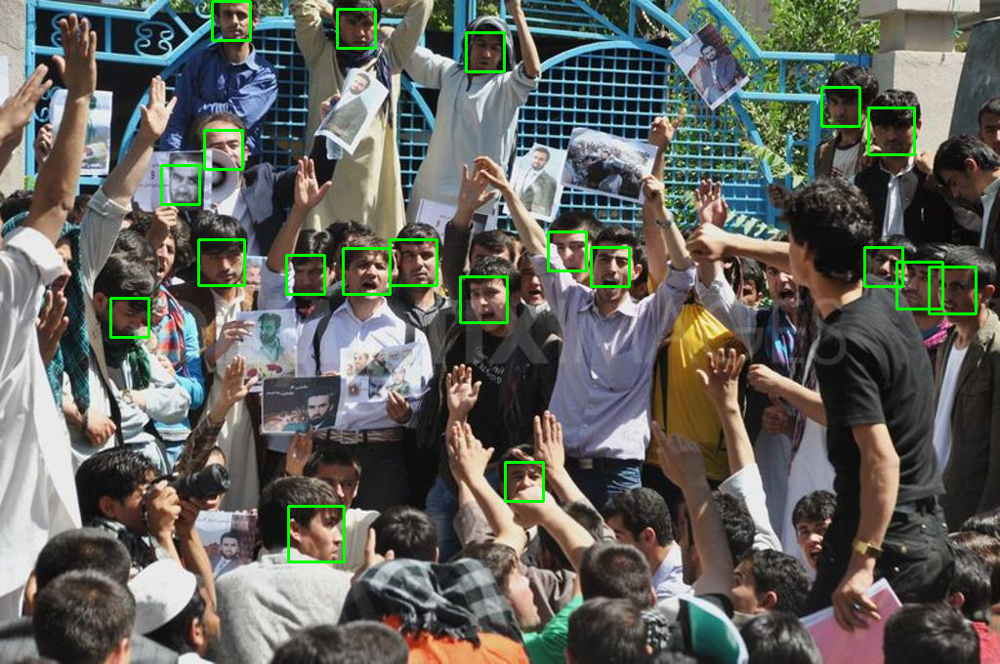

In [ ]:
res = detect_cnn(img_test)
cv2_imshow(res)

#### Wartości miar efektywności
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{20}{40})\cdot100\% = 50\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{20}{40})\cdot100\% = 50\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

## Obraz hokeistów

---



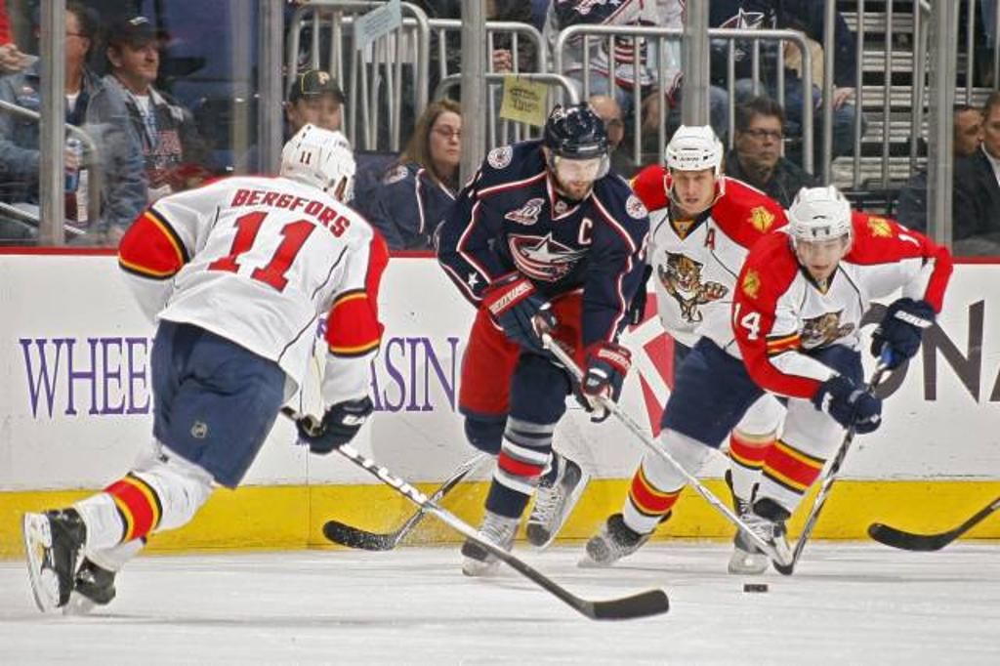

In [ ]:
cv2_imshow(img_hockey)

### Liczba twarzy
Na obrazie hokeistów doliczyłem się 10 twarzy.

### Kaskada Haara

#### Dla `minNeighbors` = 5 i `minSize` = (30, 30):




Czas wykonania kaskady Haara: 0.960s


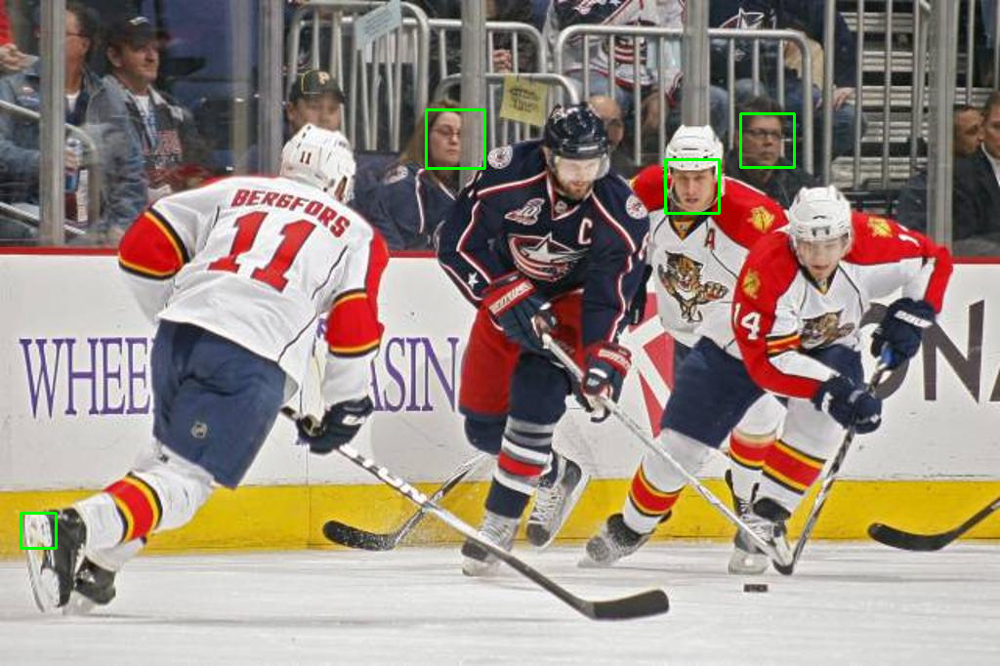

In [ ]:
res = detect_haar(img_hockey, 1.05, 5, (30, 30))
cv2_imshow(res)

##### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{3}{10})\cdot100\% = 30\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{7}{10})\cdot100\% = 70\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $1$

#### Dla `minNeighbors` = 7 i `minSize` = (30, 30):

Czas wykonania kaskady Haara: 0.923s


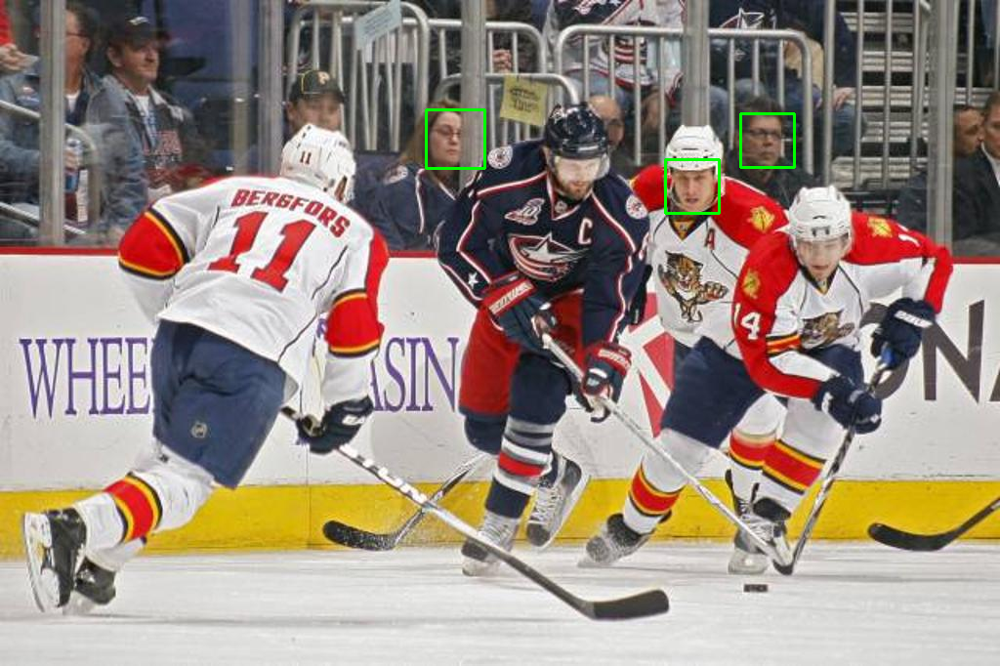

In [ ]:
res = detect_haar(img_hockey, 1.05, 7, (30, 30))
cv2_imshow(res)

##### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{3}{10})\cdot100\% = 30\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{7}{10})\cdot100\% = 70\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

#### Dla `minNeighbors` = 7 i `minSize` = (3, 3):

Czas wykonania kaskady Haara: 1.155s


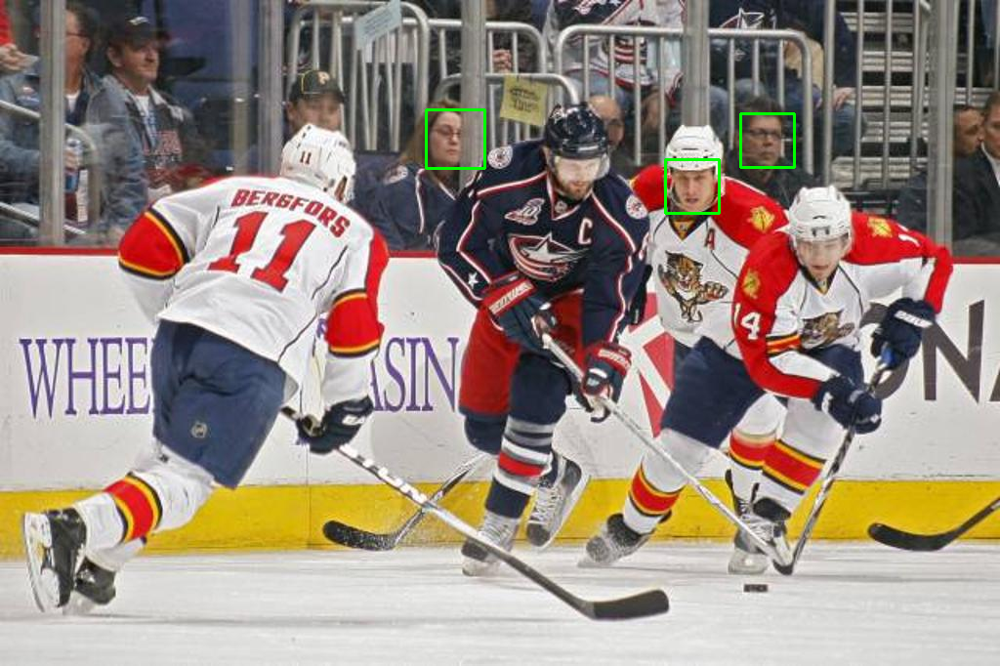

In [ ]:
res = detect_haar(img_hockey, 1.05, 7, (3, 3))
cv2_imshow(res)

##### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{3}{10})\cdot100\% = 30\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{7}{10})\cdot100\% = 70\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

### Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)



Czas wykonania HOG + SVM: 0.503s


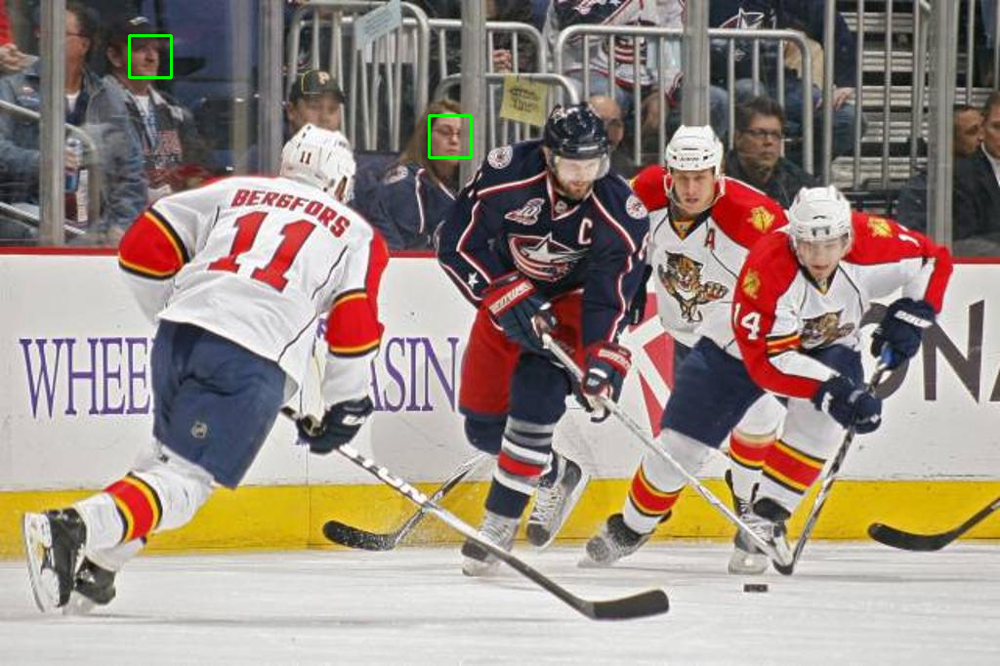

In [ ]:
res = detect_hog_svm(img_hockey)
cv2_imshow(res)

#### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{2}{10})\cdot100\% = 20\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{8}{10})\cdot100\% = 80\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

### Splotowa sieć neuronowa (CNN)

Czas wykonania CNN: 0.443s


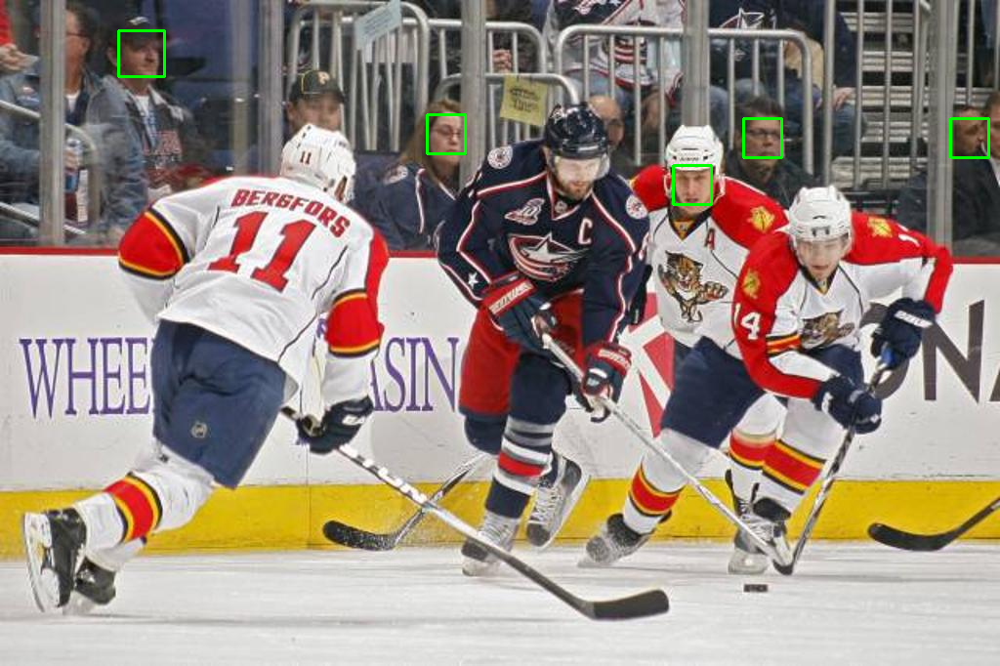

In [ ]:
res = detect_cnn(img_hockey)
cv2_imshow(res)

#### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{5}{10})\cdot100\% = 50\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{5}{10})\cdot100\% = 50\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

## Obraz piłkarzy

---



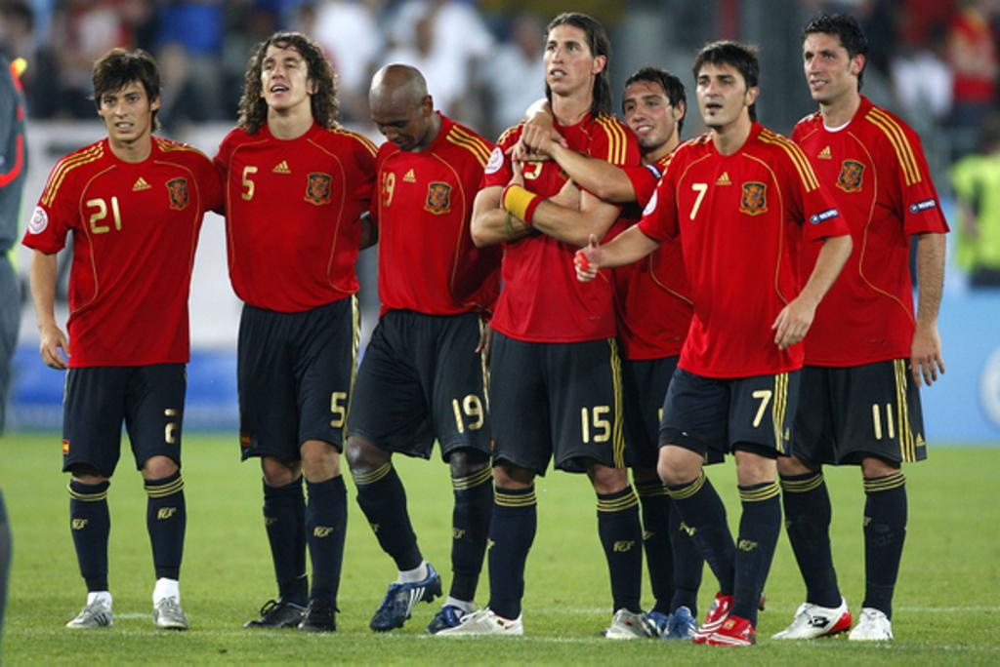

In [ ]:
cv2_imshow(img_soccer)

### Liczba twarzy
Na obrazie hokeistów doliczyłem się 7 twarzy.

### Kaskada Haara

#### Dla `minNeighbors` = 5 i `minSize` = (30, 30):

Czas wykonania kaskady Haara: 0.880s


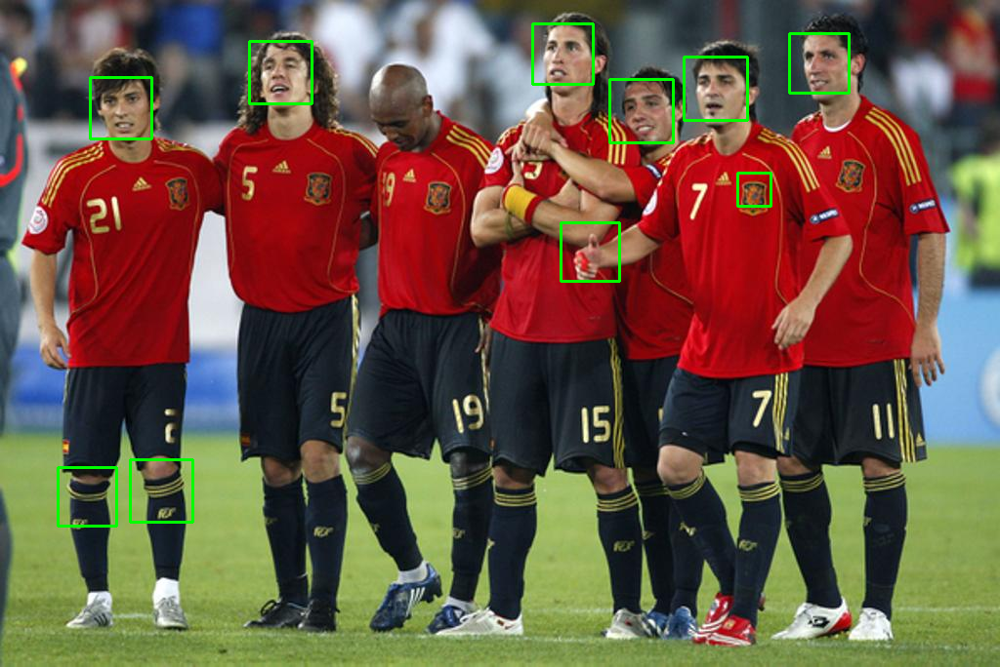

In [ ]:
res = detect_haar(img_soccer, 1.05, 5, (30, 30))
cv2_imshow(res)

##### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{6}{7})\cdot100\% \approx 86\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{1}{6})\cdot100\% \approx 17\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $4$

#### Dla `minNeighbors` = 15 i `minSize` = (30, 30):

Czas wykonania kaskady Haara: 0.837s


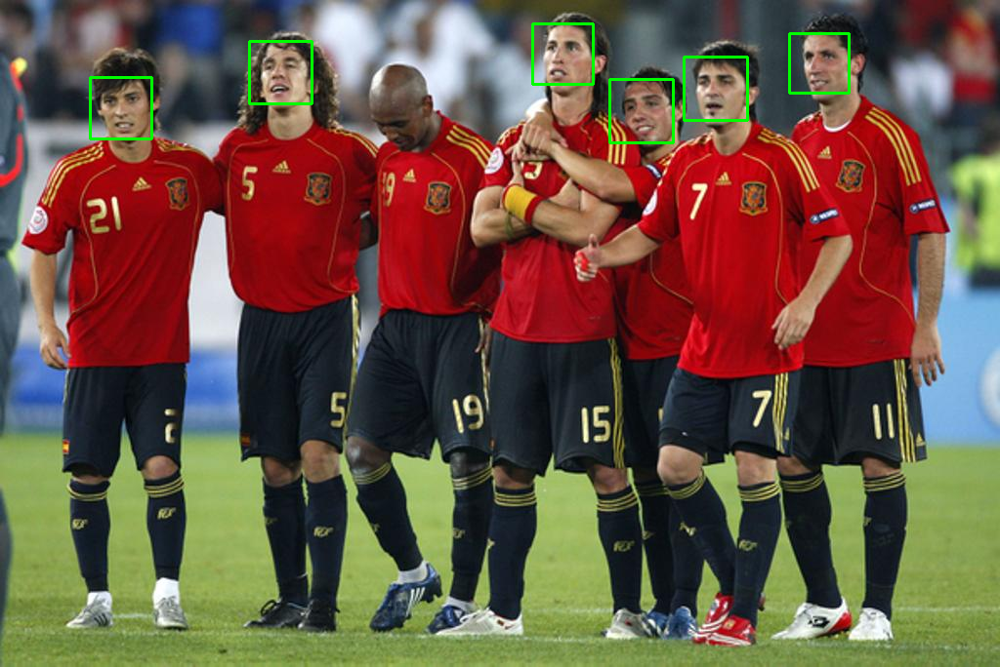

In [ ]:
res = detect_haar(img_soccer, 1.05, 15, (30, 30))
cv2_imshow(res)

##### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{6}{7})\cdot100\% \approx 86\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{1}{6})\cdot100\% \approx 17\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

#### Dla `minNeighbors` = 15 i `minSize` = (3, 3):

Czas wykonania kaskady Haara: 1.024s


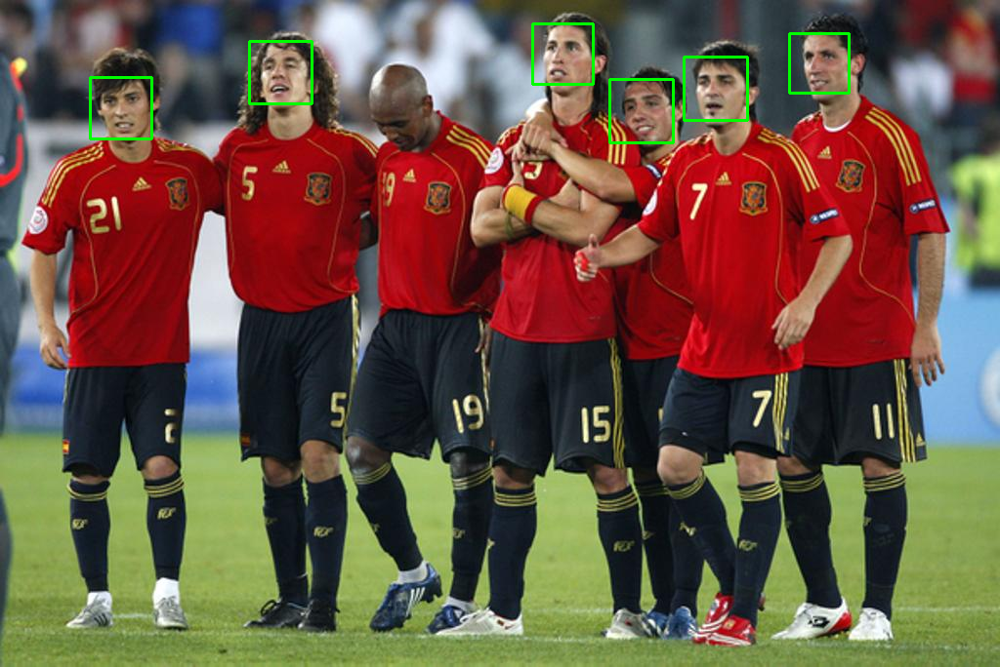

In [ ]:
res = detect_haar(img_soccer, 1.05, 15, (3, 3))
cv2_imshow(res)

##### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{6}{7})\cdot100\% \approx 86\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{1}{6})\cdot100\% \approx 17\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

### Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)


Czas wykonania HOG + SVM: 0.763s


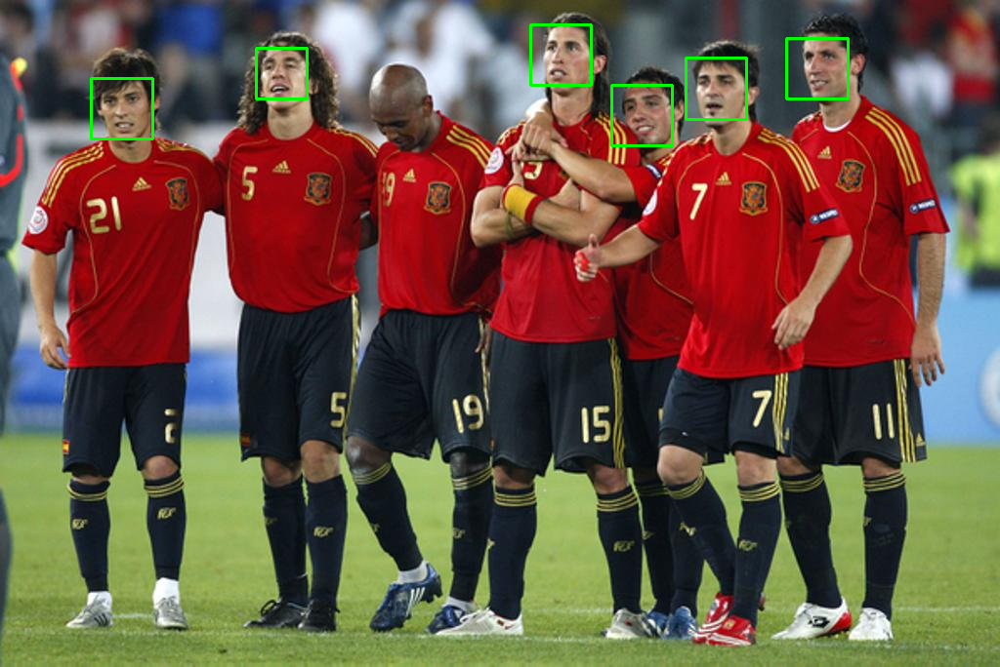

In [ ]:
res = detect_hog_svm(img_soccer)
cv2_imshow(res)

#### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{6}{7})\cdot100\% \approx 86\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{1}{6})\cdot100\% \approx 17\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

### Splotowa sieć neuronowa (CNN)

Czas wykonania CNN: 0.473s


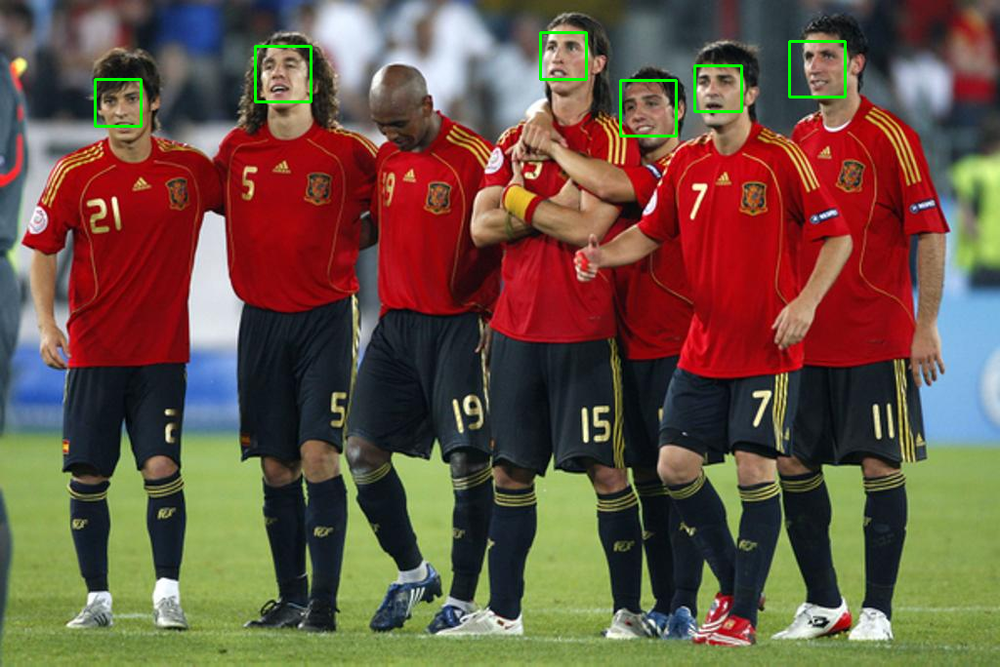

In [ ]:
res = detect_cnn(img_soccer)
cv2_imshow(res)

#### Wartości miar efektywności:
- procent poprawnie wykrytych twarzy w obrazie: $(\frac{6}{7})\cdot100\% \approx 86\%$
- procent/liczba niewykrytych twarzy w obrazie: $(\frac{1}{6})\cdot100\% \approx 17\%$
- liczba obiektów niepoprawnie rozpoznanych jako twarze: $0$

## Porównanie algorytmów

---





### Kaskada Haara

- Bardzo często algorytm rozpoznaje inne obiekty jako twarze (false-positives) - szczególnie widać to na obrazie piłkarzy, gdzie algorytm bez nastrojonych parametrów wykrył aż 4 obiekty niebędące twarzami.
- Często żeby zmniejszyć liczbę false-positives trzeba ręcznie nastrajać parametry - dla każdego obrazu przeprowadziłem testy dla różnych wartości parametrów.
- Zwiększając parametr `minNeighbors` zmniejszamy liczbę wystąpień false-positives - dla każdego obrazu zwiększając parametr `minNeighbors` doprowadziłem do stanu gdzie algorytm nie wykrywa obiektów nie będących twarzami. Można zauważyć, że dla obrazu piłkarzy algorytm przestał wykrywać obiekty nie będące twarzami dopiero po trzykrotnym zwiększeniu tego parametru.
- Zmniejszając szerokość i wysokość podaną w `minSize` zmniejszamy najmniejszy rozmiar okna, co skutkuje zwiększeniem skuteczności wykrycia twarzy algorytmu, ale zwiększa złożoność obliczeniową. Można zauważyć, że dla obrazu testowego zmniejszając wartości parametru `minSize` trzykrotnie algorytm wykrył 1 twarz więcej - zatem poprawa w skuteczności jest bardzo nieznaczna.
- Jest szybki - każde przetestowane przeze mnie wykonanie algorytmu nie zajmowało dłużej niż 1.5s.
- Model zajmuje bardzo mało pamięci - 930kB.
- Słabo wykrywa twarze obrócone, widoczne z profilu, pod różnymi kątami.
- Słabo wykrywa twarze częściowo przysłonięte.
- Dość dokładnie wykrywa położenie twarzy.

### Histogram zorientowanych gradientów (HOG) z maszyną wektorów nośnych (SVM)

- Jest szybki i wydajny.
- Słabo radzi sobie z wykrywaniem twarzy obróconych pod różnym kątem lub widocznymi z profilu.
- Słabo radzi sobie z wykrywaniem twarzy częściowo przysłoniętych.
- Dość dokładnie wykrywa położenie twarzy.
- Bardzo rzadko rozpoznaje inne obiekty jako twarze (false-positives) - we wszystkich trzech testowanych przeze mnie obrazach algorytm ani razu się nie pomylił.
- Ma podobną skuteczność wykrywania twarzy co algorytm kaskady Haara.



### Splotowa sieć neuronowa (CNN)

- Jest wolniejszy od wcześniejszych algorytmów, jednakże w tym przypadku obliczenia przeprowadzane są na GPU, dlatego różnic tych nie widać na zmierzonych przeze mnie czasach.
- Jest zdecydowanie najefektywniejsza - rozpoznaje twarze dużo lepiej od poprzednich algorytmów. Szczególnie widać tę różnicę na obrazie testowym i obrazie hokeistów, gdzie poprzednie algorytmy nie osiągnęły większej skuteczności wykrycia twarzy niż $30\%$, a CNN osiągnął skuteczność aż $50\%$.
- Bardzo rzadko rozpoznaje inne obiekty jako twarze (false-positives) - we wszystkich trzech testowanych przeze mnie obrazach algorytm ani razu się nie pomylił.
- Jako jedyny z testowanych algorytmów radzi sobie dobrze również z twarzami widocznymi z profilu, z różnych kątów, czy częściowo przysłoniętymi.
- Zaskakująco słabo CNN poradziła sobie z twarzami wydrukowanymi na papierze w obrazie testowym - lepiej poradził sobie z ich wykryciem nawet algorytm kaskady Haara.
- Dobrze radzi sobie z twarzami rozmytymi - można to zauważyć na obrazie hokeistów.